[0.16343845 0.20774089 0.35413736 ... 0.16564368 0.1425273  0.2719729 ]


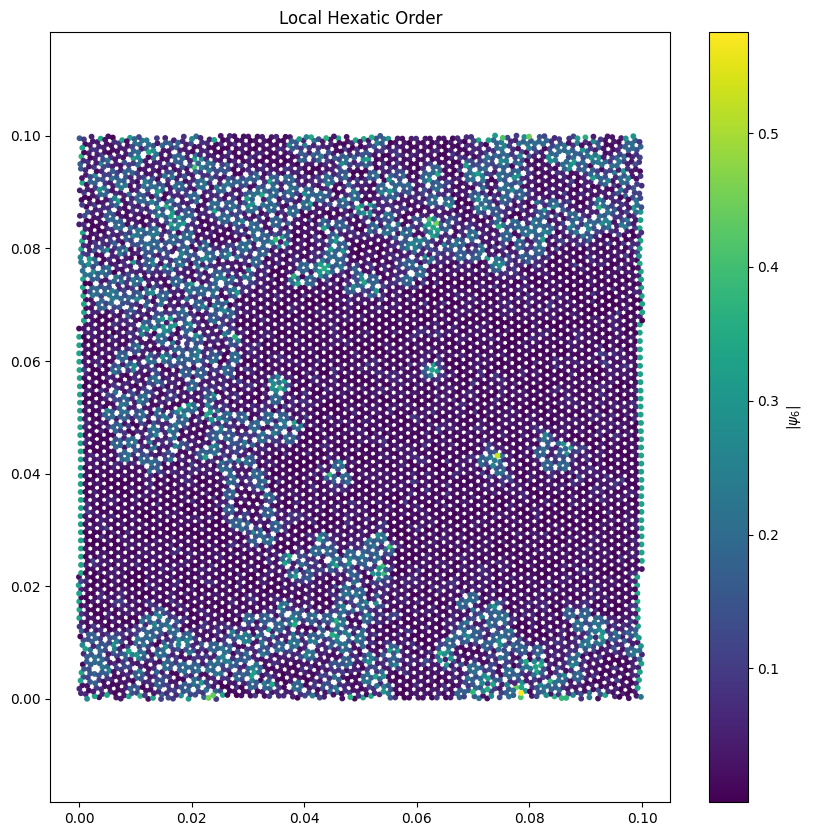

In [1]:
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt

T = 9690
traj = md.load_lammpstrj(f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj', top='graphene_topology.pdb')

# 2) Extract the first frame’s XY coords and embed in 3D (z=0)
xy = traj.xyz[-1, :, :2].astype(np.float32)       # (N,2)
points = np.zeros((xy.shape[0], 3), dtype=np.float32)
points[:, :2] = xy                               # (N,3)

# 3) Build a 2D box for freud by passing a length-2 list [Lx, Ly]
v1, v2, _ = traj.unitcell_vectors[0]
Lx, Ly = np.linalg.norm(v1), np.linalg.norm(v2)
box2d = [Lx, Ly]  # freud treats length-2 lists as 2D boxes :contentReference[oaicite:0]{index=0}

# 4) Compute per-particle hexatic order ψ₆
hexatic = freud.order.Hexatic(k=6)               # 2D hexatic (k-atic) order :contentReference[oaicite:1]{index=1}
hexatic.compute(system=(box2d, points))

psi6 = hexatic.particle_order                    # complex ψ₆ per particle
mag_psi6 = np.abs(psi6)                           # |ψ₆|
print(mag_psi6)

plt.figure(figsize=(10,10))
plt.scatter(points[:, 0], points[:, 1], c=mag_psi6, s=10, cmap='viridis')
plt.axis('equal')
plt.colorbar(label=r'$|\psi_6|$')
plt.title('Local Hexatic Order')
plt.show()


In [16]:
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt

# 1) Load your trajectory & topology
T = 9690
traj = md.load_lammpstrj(f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj',
                         top='graphene_topology.pdb')

# 2) Extract the last frame’s XY coords (z=0)
xy = traj.xyz[-1, :, :2].astype(np.float32)       # (N,2)
points = np.zeros((xy.shape[0], 3), dtype=np.float32)
points[:, :2] = xy                                # (N,3)

# 3) Build a 2D periodic box from your unit cell
v1, v2, _ = traj.unitcell_vectors[0]
Lx, Ly = np.linalg.norm(v1), np.linalg.norm(v2)
box2d = [Lx, Ly]  # freud treats length-2 lists as 2D boxes

# 4) Instantiate the BondOrder “diagram” object
#    l=6 for hexagonal order; r_max just beyond 1st neighbor shell
#    n_r, n_theta control the histogram resolution (feel free to tweak)
bod = freud.environment.BondOrder(
    l=6,
    r_max=1.5,
    n_r=50,
    n_theta=180,
)

# 5) Compute the 2D bond-order histogram, using 12 neighbors per particle
res = bod.compute(
    system=(box2d, points),
    neighbors={'num_neighbors': 12}
)

# 6) Extract and clip the bond_order array for plotting
bod_array = res.bond_order
# Clip top 1% to avoid outliers dominating the color scale
bod_array = np.clip(bod_array, 0, np.percentile(bod_array, 99))

# 7) Plot exactly as in the docs
plt.figure(figsize=(6, 6))
plt.imshow(
    bod_array.T,
    origin='lower',
    aspect='auto',
    interpolation='nearest'
)
plt.xlabel('Radial bin $i$')
plt.ylabel('Angular bin $j$')
plt.title(r'Bond Order Diagram $\psi_6(r, \theta)$')
plt.colorbar(label='Probability density')
plt.tight_layout()
plt.show()


TypeError: BondOrder.__init__() got an unexpected keyword argument 'l'

In [1]:
import MDAnalysis as mda
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt
u = mda.Universe('../output/GAMMAS/300/anneal_300K.lammpstrj', format='LAMMPSDUMP')
u.atoms.write('graphene_topology.pdb')
print("Conversion complete: 'system.pdb' created.")

c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\MDAnalysis\topology\LAMMPSParser.py:651: UserWarning: Guessed all Masses to 1.0
  warnings.warn("Guessed all Masses to 1.0")
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\MDAnalysis\coordinates\LAMMPS.py:751: UserWarning: Reader has no dt information, set to 1.0 ps
  ts.data["time"] = step_num * ts.dt
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\MDAnalysis\coordinates\PDB.py:1154: UserWarning: Found no information for attr: 'altLocs' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\MDAnalysis\coordinates\PDB.py:1154: UserWarning: Found no information for attr: 'r

Conversion complete: 'system.pdb' created.


In [3]:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern"],
    # optionally make all font sizes a bit larger for publication
    "font.size": 14,
    "axes.labelsize": 14,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "legend.fontsize": 12,
})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

In [8]:
import numpy as np
import mdtraj as md
import freud
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

# Your four temperatures
temps = [(8700, "0.598", 10), (9750, "3.665",1.7e3), (9900, "4.058",1.7e3), (11000, "4.746",1.7e3)]

fig = plt.figure(figsize=(14, 14), dpi=800)

# Create a 2×2 grid; axes_pad controls BOTH horiz & vert spacing.
# cbar_mode='single' makes one colorbar.  cbar_location & cbar_pad place it.
grid = ImageGrid(
    fig, 111,                    # whole-figure, 1×1 grid placeholder
    nrows_ncols=(2, 2),          # your panel layout
    axes_pad=0.5,                # spacing between panels
    share_all=True,              # share x & y limits
    cbar_mode='single',          # one colorbar for all
    cbar_location='right',       # put it on the right
    cbar_pad=0.1                 # space between panels and colorbar
)

# Loop through each axes in the grid
for ax, (T, G, s) in zip(grid, temps):
    # 1) Load trajectory
    traj = md.load_lammpstrj(
        f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj',
        top='graphene_topology.pdb'
    )

    # 2) Extract final x,y
    xy = traj.xyz[-1, :, :2].astype(np.float32)
    points = np.zeros((xy.shape[0], 3), np.float32)
    points[:, :2] = xy

    # 3) Build freud box
    v1, v2, _ = traj.unitcell_vectors[0]
    box2d = [np.linalg.norm(v1), np.linalg.norm(v2)]

    # 4) Compute hexatic order
    hexatic = freud.order.Hexatic(k=6)
    hexatic.compute(system=(box2d, points))
    mag_psi6 = np.abs(hexatic.particle_order)

    # 5) Scatter
    sc = ax.scatter(
        points[:, 0] * s,
        points[:, 1] * s,
        c=mag_psi6, s=6, cmap='viridis'
    )

    # Uniform axes limits & aspect
    ax.set_xlim(0, 170)
    ax.set_ylim(0, 170)
    ax.set_aspect('equal')
    ax.set_title(rf"$\Gamma$ = {G}", pad=6, fontsize=30)



# Add axis labels on the remaining axes
grid[2].set_xlabel(r"$x$ (Å)", fontsize=30)
grid[3].set_xlabel(r"$x$ (Å)", fontsize=30)
grid[0].set_ylabel(r"$y$ (Å)", fontsize=30)
grid[2].set_ylabel(r"$y$ (Å)", fontsize=0)

# Create the single colorbar in the grid’s cbar_axes[0]
cbar = grid.cbar_axes[0].colorbar(sc)
cbar.set_label(r"$|\psi_6|$", fontsize=30)

plt.savefig("../output/local_hexatic_order.png",dpi=800)
plt.show()
